# Airbnb Analysis

Thhis analysis is of airbnb's from Seattle. The datasets `calendar.csv`, `reviews.csv`, `listings.csv` all available from www.kaggle.com website. We will do some work to analyse these datasets to see what questions could be answered.

## Discovery of Datasets

Import packages, and take a quick peek of the 3 datasets given.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

init_notebook_mode(connected=True)

In [2]:
calendar = pd.read_csv('calendar.csv')
listings = pd.read_csv('listings.csv')
reviews = pd.read_csv('reviews.csv')

In [3]:
calendar.head()

,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
2,241032,2016-01-06,f,NaN
3,241032,2016-01-07,f,NaN
4,241032,2016-01-08,f,NaN


In [4]:
calendar.describe()

,listing_id
count,1.393570e+06
mean,5.550111e+06
std,2.962274e+06
min,3.335000e+03
25%,3.258213e+06
50%,6.118244e+06
75%,8.035212e+06
max,1.034016e+07


### Questions from this dataset:

- When are airbnb's most busy?
- When are prices the the highest vs the lowest?
- Does availability determine price change or does time of the year determine prices?

In [5]:
listings.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,...,10.0,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",...,10.0,f,NaN,WASHINGTON,f,strict,t,t,6,1.48
2,3308979,https://www.airbnb.com/rooms/3308979,20160104002432,2016-01-04,New Modern House-Amazing water view,New modern house built in 2013. Spectacular s...,"Our house is modern, light and fresh with a wa...",New modern house built in 2013. Spectacular s...,none,Upper Queen Anne is a charming neighborhood fu...,...,10.0,f,NaN,WASHINGTON,f,strict,f,f,2,1.15
3,7421966,https://www.airbnb.com/rooms/7421966,20160104002432,2016-01-04,Queen Anne Chateau,A charming apartment that sits atop Queen Anne...,NaN,A charming apartment that sits atop Queen Anne...,none,NaN,...,NaN,f,NaN,WASHINGTON,f,flexible,f,f,1,NaN
4,278830,https://www.airbnb.com/rooms/278830,20160104002432,2016-01-04,Charming craftsman 3 bdm house,Cozy family craftman house in beautiful neighb...,Cozy family craftman house in beautiful neighb...,Cozy family craftman house in beautiful neighb...,none,We are in the beautiful neighborhood of Queen ...,...,9.0,f,NaN,WASHINGTON,f,strict,f,f,1,0.89


### Questions from Listings Dataset:

- What words from the name in the title attract the most persons? 
- What words from the beginning of the name attract persons? Which names attract least?
- What word count from `space` attract the most persons?
- Does neighborhood always mean better reviews?
- What affects the review scores (`review_scores_value`) the most?
- Does being instantly bookable(`instant_bookable`) have a correlation with rating?
- Does rating have a correlation how much business the airbnb is getting?


In [6]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,7202016,38917982,2015-07-19,28943674,Bianca,Cute and cozy place. Perfect location to every...
1,7202016,39087409,2015-07-20,32440555,Frank,Kelly has a great room in a very central locat...
2,7202016,39820030,2015-07-26,37722850,Ian,"Very spacious apartment, and in a great neighb..."
3,7202016,40813543,2015-08-02,33671805,George,Close to Seattle Center and all it has to offe...
4,7202016,41986501,2015-08-10,34959538,Ming,Kelly was a great host and very accommodating ...


### Questions from Reviews Dataset

Nothing right now to ask of this dataset. This can be used as a field to merge to other tables.

-------------------------------------------------------------------------------

## Clean Datasets

Let's start to clean these datasets.

### Calendar

- Price needs to be cleaned.
    - change string to float
- date needs to be changed to datetime datatype.

In [7]:
# change calendar date object type to datetime type

calendar.date = pd.to_datetime(calendar.date)

# change calendar price string type to float, remove '$' from beginning of string

calendar.price = calendar.price.str[1:]

calendar.price = calendar.price.str.replace(',','')

calendar.price = calendar.price.astype(float)

In [8]:
calendar.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1393570 entries, 0 to 1393569
Data columns (total 4 columns):
listing_id    1393570 non-null int64
date          1393570 non-null datetime64[ns]
available     1393570 non-null object
price         934542 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 42.5+ MB


---------------------------------------------------------------

## Discover

Exploratory analysis of these datasets beginning with `calendar.csv`.

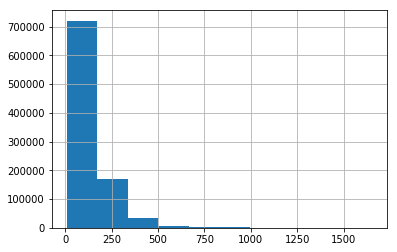

In [9]:
calendar.price.hist();

In [10]:
calendar.date.dt.month.value_counts()

12    118358
10    118358
8     118358
7     118358
5     118358
3     118358
11    114540
9     114540
6     114540
4     114540
1     114540
2     110722
Name: date, dtype: int64

In [11]:
# show what month this date was in
calendar['Month'] = calendar.date.dt.month 

In [12]:
calendar.available = calendar.available.map({'t':1,'f':0})

In [13]:
calendar.groupby('Month').agg({'Month':'count','available':'sum'}).sort_values(by='available')

,Month,available
Month,,
1,114540,64937
2,110722,73321
7,118358,74222
4,114540,76037
8,118358,76347
6,114540,77244
9,114540,77246
5,118358,79971
11,114540,81780


As can be seen above, the months when airbnb's are the most available in Seattle is December, March, November. The monsth when it is the most busy and least available are January, Februrary.

In [14]:
listings.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'summary',
       'space', 'description', 'experiences_offered', 'neighborhood_overview',
       'notes', 'transit', 'thumbnail_url', 'medium_url', 'picture_url',
       'xl_picture_url', 'host_id', 'host_url', 'host_name', 'host_since',
       'host_location', 'host_about', 'host_response_time',
       'host_response_rate', 'host_acceptance_rate', 'host_is_superhost',
       'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood',
       'host_listings_count', 'host_total_listings_count',
       'host_verifications', 'host_has_profile_pic', 'host_identity_verified',
       'street', 'neighbourhood', 'neighbourhood_cleansed',
       'neighbourhood_group_cleansed', 'city', 'state', 'zipcode', 'market',
       'smart_location', 'country_code', 'country', 'latitude', 'longitude',
       'is_location_exact', 'property_type', 'room_type', 'accommodates',
       'bathrooms', 'bedrooms', 'beds', 'bed_type', 'amenities', '

In [15]:
listings.review_scores_communication[:5]

0    10.0
1    10.0
2    10.0
3     NaN
4    10.0
Name: review_scores_communication, dtype: float64

### Interesting columns and Thoughts

- host_since
- host_about
- host_response_rate
- host_is_superhost
- host_acceptance_rate
- host_neighbourhood
- host_has_profile_pic
- accommodates
- bathrooms
- bedrooms
- security_deposit
- number_of_reviews
- review_scores_accuracy
- review_scores_cleanliness
- review_scores_checkin
- review_scores_communication
- review_scores_location
- review_scores_value
- instant_bookable
- cancellation_policy
- reviews_per_month





In [16]:
listings.host_since = pd.to_datetime(listings.host_since)

In [17]:
listings.host_since.dt.year.value_counts()

2015.0    981
2014.0    900
2013.0    776
2012.0    539
2011.0    398
2010.0    149
2009.0     64
2016.0      5
2008.0      4
Name: host_since, dtype: int64

In [18]:
listings.review_scores_value.value_counts()

10.0    1775
9.0     1137
8.0      190
7.0       38
6.0       16
4.0        4
5.0        1
2.0        1
Name: review_scores_value, dtype: int64

In [19]:
 listings.review_scores_cleanliness.value_counts()

10.0    2161
9.0      740
8.0      184
7.0       40
6.0       30
5.0        5
4.0        4
3.0        1
Name: review_scores_cleanliness, dtype: int64

In [20]:
listings.host_response_rate = listings.host_response_rate.str[0:-1].astype(float)

In [21]:
listings.host_is_superhost = listings.host_is_superhost.map({'t':1,'f':0})

In [22]:
listings.instant_bookable = listings.instant_bookable.map({'t':1,'f':0})

In [23]:
listings.host_acceptance_rate = listings.host_acceptance_rate.str[0:-1].astype(float)

In [24]:
listings.host_has_profile_pic = listings.host_has_profile_pic.map({'t':1,'f':0})

In [25]:
listings_corr = listings[['host_response_rate','host_is_superhost','host_acceptance_rate','review_scores_value',
                          'accommodates','instant_bookable','bedrooms','bathrooms','host_acceptance_rate',
                         'host_has_profile_pic']]



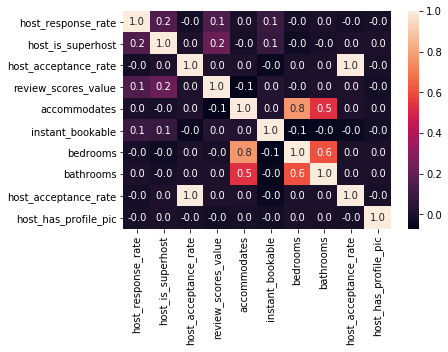

In [26]:
sns.heatmap(listings_corr.corr(), annot=True, fmt='.1f');

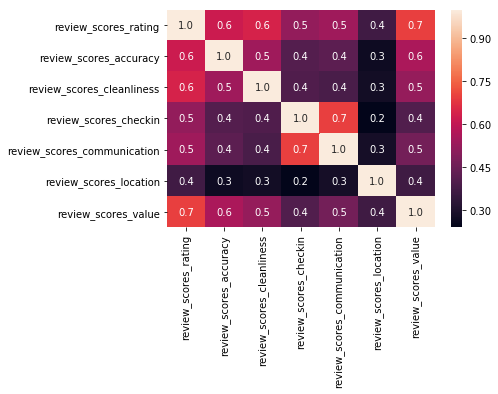

In [27]:
reviews_sep = listings[['review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value']]

sns.heatmap(reviews_sep.corr(), annot=True, fmt='.1f');

### Availability of Airbnb's

We will take a look at the amount of Airbnb's over the years, and also look at the availability over the years. Do Airbnb's in Seattle get more busy? Or is there more popping up and becoming less busy?

In [28]:
timeseries = calendar.groupby('Month').agg({'available':'sum'})

In [29]:
data = [go.Scattergl(
          x=[1,2,3,4,5,6,7,8,9,10,11,12],
          y=timeseries.available)]

layout = dict(
    title = "Availability Per Month",
    xaxis = dict(
        range = ['2060-1-1','2016-12-31'])
)

fig = dict(data=data, layout=layout)

py.iplot(fig)



Looking at the availability per month we can see that during the summer months the availability is low as the summer months are more busy. Between October and January the availability is quite high. This should mean that the price should be lower in the summer. Let's take a look.

In [30]:
timeseries_price = calendar.groupby('Month').agg({'price':'mean'})

In [31]:
data = [go.Scattergl(
          x=[1,2,3,4,5,6,7,8,9,10,11,12],
          y=timeseries_price.price)]

layout = dict(
    title = "Price Per Month",
    xaxis = dict(
        range = ['2060-1-1','2016-12-31'])
)

fig = dict(data=data, layout=layout)

py.iplot(fig)

Now, looking at the prices per month, we can see in the trend that the prices go up in the summer at a similar rate that the availability decreases. Therefore, there is a direct correlation in availability and price.

In [32]:
# create a function for aggregate so that those found greater than a certain amount is true
def high_available(x):
    if x > 0.85:
        return 'yes'

In [33]:
calendar_group = calendar.groupby('listing_id').agg({'listing_id':'nunique','available':['mean','sum']})

In [34]:
calendar_group.head(3)

listing_id available     
              nunique      mean  sum
listing_id                          
3335                1  0.846575  309
4291                1  1.000000  365
5682                1  0.846575  309

In [35]:
# create a list with all of the id's that are low availability ( under 25%)
low_avail_list = calendar_group[calendar_group['available']['mean'] < 0.25]['listing_id'].index.tolist()

In [36]:
print(calendar[calendar.listing_id.isin(low_avail_list)].shape)
print(calendar.shape)

print("Percentage of low availability : {:f}".format(calendar[calendar.listing_id.isin(low_avail_list)].shape[0] / calendar.shape[0]))

(282510, 5)
(1393570, 5)
Percentage of low availability : 0.202724


In [37]:
low_avail_df = calendar[calendar.listing_id.isin(low_avail_list)]

As we can see, approximately 20% of records have low availability. We will be working with these to find more insights.

In [38]:
print("Is Null: ", low_avail_df.price.isnull().sum())
print("Not Null: ", low_avail_df.price.notnull().sum())
print("Percentage Null: ", low_avail_df.price.isnull().sum() / low_avail_df.shape[0])

Is Null:  246436
Not Null:  36074
Percentage Null:  0.8723089448161127


### Ratings

What affects ratings the most? How as a host do we receive higher ratings?

In [39]:
print(calendar.shape[0])
print(listings.shape[0])

1393570
3818


In [40]:
calendar.columns

Index(['listing_id', 'date', 'available', 'price', 'Month'], dtype='object')

In [41]:
reviews.columns

Index(['listing_id', 'id', 'date', 'reviewer_id', 'reviewer_name', 'comments'], dtype='object')

In [42]:
listings.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'summary',
       'space', 'description', 'experiences_offered', 'neighborhood_overview',
       'notes', 'transit', 'thumbnail_url', 'medium_url', 'picture_url',
       'xl_picture_url', 'host_id', 'host_url', 'host_name', 'host_since',
       'host_location', 'host_about', 'host_response_time',
       'host_response_rate', 'host_acceptance_rate', 'host_is_superhost',
       'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood',
       'host_listings_count', 'host_total_listings_count',
       'host_verifications', 'host_has_profile_pic', 'host_identity_verified',
       'street', 'neighbourhood', 'neighbourhood_cleansed',
       'neighbourhood_group_cleansed', 'city', 'state', 'zipcode', 'market',
       'smart_location', 'country_code', 'country', 'latitude', 'longitude',
       'is_location_exact', 'property_type', 'room_type', 'accommodates',
       'bathrooms', 'bedrooms', 'beds', 'bed_type', 'amenities', '

In [43]:
listings.rename(columns={'id':'listing_id'}, inplace=True)

In [44]:
# need to combine low availability with listings so only those show
listings_combined = listings.merge(low_avail_df,on='listing_id')

In [45]:
# what are the top 10 words used for the most busy airbnb's?
listings_combined.name.str.split(expand=True)[0].value_counts()[:10]

Cozy        20805
Modern      12775
Private     10950
Spacious     8395
Charming     7300
Bright       6935
The          6570
Capitol      6205
1            5475
Sunny        5475
Name: 0, dtype: int64

In [46]:
# need to combine low availability with listings so only those show
listings_combined = listings.merge(high_avail_df,on='listing_id')

NameError: name 'high_avail_df' is not defined

In [47]:


trace0 = go.Bar(
            x=['Cozy','Modern', 'Private','Spacious','Charming','Bright'],
            y=listings_combined.name.str.split(expand=True)[0].value_counts(),
            marker=dict(
                color=['rgba(222,45,38,0.8)','rgba(204,204,204,1)',
                   'rgba(204,204,204,1)', 'rgba(204,204,204,1)',
                   'rgba(204,204,204,1)','rgba(204,204,204,1)']) ,
    )

data = [trace0]
layout = go.Layout(
        title='Top Words Used In Title')

fig = go.Figure(data=data, layout=layout)

py.iplot(fig)

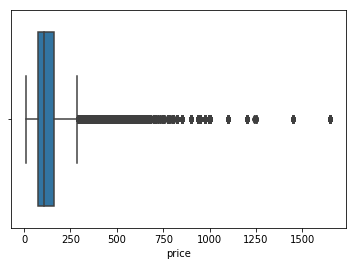

In [52]:
sns.boxplot(calendar.price);

In [53]:
trace0 = go.Box(x=calendar.price)
data = [trace0]
py.iplot(data)

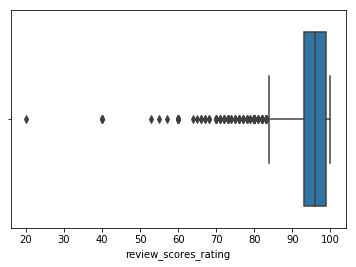

In [54]:
sns.boxplot(listings.review_scores_rating);

In [55]:
listings.review_scores_rating.describe()

count    3171.000000
mean       94.539262
std         6.606083
min        20.000000
25%        93.000000
50%        96.000000
75%        99.000000
max       100.000000
Name: review_scores_rating, dtype: float64